# BossaGroove Analysis :drum:

In [1]:
import pickle
import numpy as np
import keras
import pandas as pd
from scipy.special import kl_div
import matplotlib.pyplot as plt
import pretty_midi
from IPython.display import display
from IPython.display import Image, Audio

In [2]:
# Load original and predicted velocity pickle files
with open('outputs/hits_orig.pkl', 'rb') as f:
    hits_orig = pickle.load(f)

with open('outputs/velocities_orig.pkl', 'rb') as f:
    velocity_orig = pickle.load(f)

with open('outputs/velocities_pred.pkl', 'rb') as f:
    velocity_pred = pickle.load(f)

with open('outputs/offsets_orig.pkl', 'rb') as f:
    offsets_orig = pickle.load(f)

with open('outputs/offsets_pred.pkl', 'rb') as f:
    offsets_pred = pickle.load(f)

In [3]:
# Make the non-hits velocities and offsets NaN
velocity_orig[hits_orig == 0] = np.nan
velocity_pred[hits_orig == 0] = np.nan
offsets_orig[hits_orig == 0] = np.nan
offsets_pred[hits_orig == 0] = np.nan
epsilon = 1e-8


In [4]:
def plot_beat_distribution_at_pos_with_step(arr_orig, arr_pred, i, step, title):
    # Example histograms
    histogram1, bins1 = np.histogram(arr_orig[:,i::step,:][~np.isnan(arr_orig[:,i::step,:])], bins=50, density=True)
    histogram2, bins2 = np.histogram(arr_pred[:,i::step,:][~np.isnan(arr_pred[:,i::step,:])], bins=50, density=True)

    # Plot histogram of original and predicted velocities
    plt.figure()
    plt.hist(bins1[:-1], bins1, weights=histogram1, alpha=0.5, label='Original')
    plt.hist(bins2[:-1], bins2, weights=histogram2, alpha=0.5, label='Predicted')
    plt.legend()
    plt.xlabel(f'Drum Hit {title}')
    plt.ylabel('Count')
    plt.title(f'Histogram of original and predicted {title}')
    plt.show()

    # 1. Histogram Intersection
    hist_intersection = np.sum(np.minimum(histogram1/np.sum(histogram1), histogram2/np.sum(histogram2)))
    print("Histogram Intersection:", hist_intersection)


    # 2. KL Divergence
    histogram1_normalized = histogram1+epsilon / np.sum(histogram1+epsilon)
    histogram2_normalized = histogram2+epsilon / np.sum(histogram2+epsilon)
    kl_divergence = kl_div(histogram2_normalized, histogram1_normalized).sum()
    print("KL Divergence:", kl_divergence)

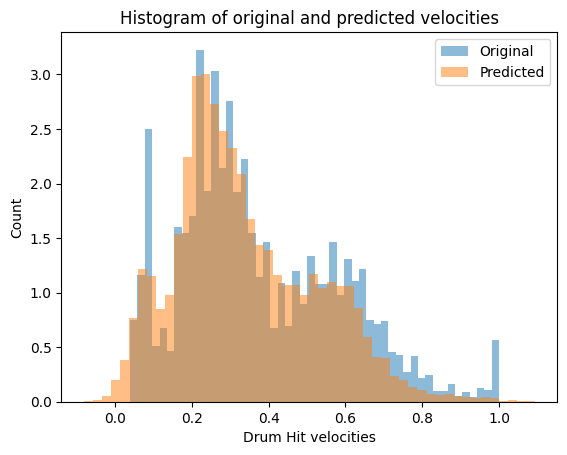

Histogram Intersection: 0.7660229475928251
KL Divergence: 9.579961273082322


In [5]:
plot_beat_distribution_at_pos_with_step(velocity_orig, velocity_pred, 0, 1, "velocities")

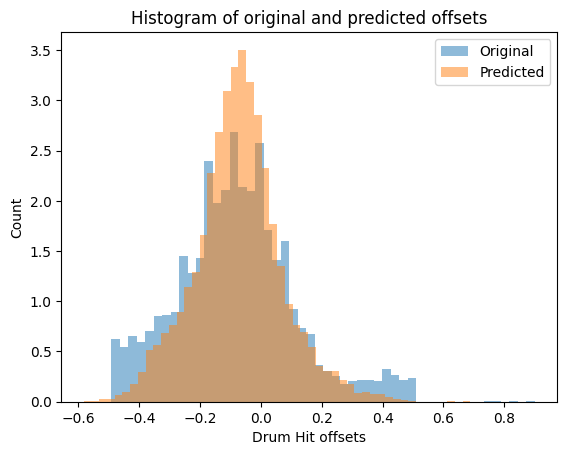

Histogram Intersection: 0.6054991780213134
KL Divergence: 23.966178239284627


In [6]:
plot_beat_distribution_at_pos_with_step(offsets_orig, offsets_pred, 0, 1, "offsets")

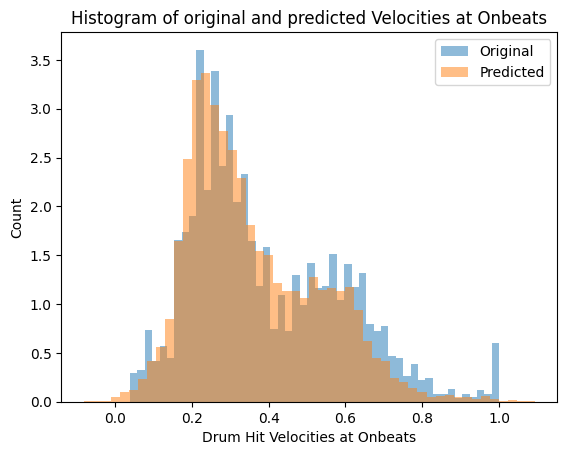

Histogram Intersection: 0.7435995921978789
KL Divergence: 10.043608042686747


In [7]:
plot_beat_distribution_at_pos_with_step(velocity_orig, velocity_pred, 0, 2, "Velocities at Onbeats")

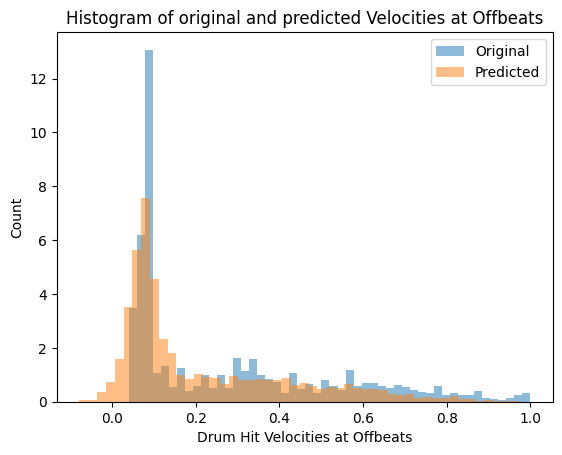

Histogram Intersection: 0.47762557346341894
KL Divergence: 53.39899518130405


In [8]:
plot_beat_distribution_at_pos_with_step(velocity_orig, velocity_pred, 1, 2, "Velocities at Offbeats")

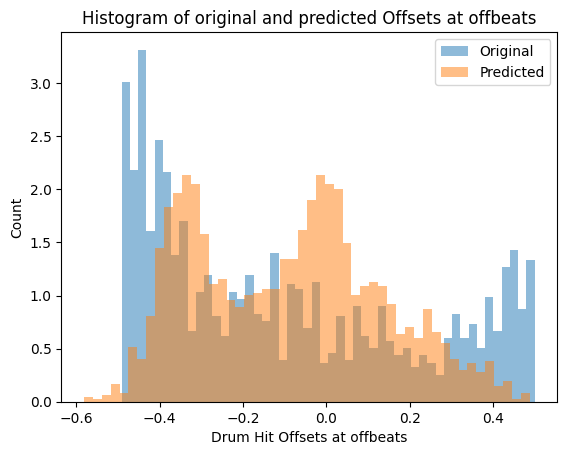

Histogram Intersection: 0.5602739677706816
KL Divergence: 27.654400679286436


In [9]:
plot_beat_distribution_at_pos_with_step(offsets_orig, offsets_pred, 1, 2, "Offsets at offbeats")

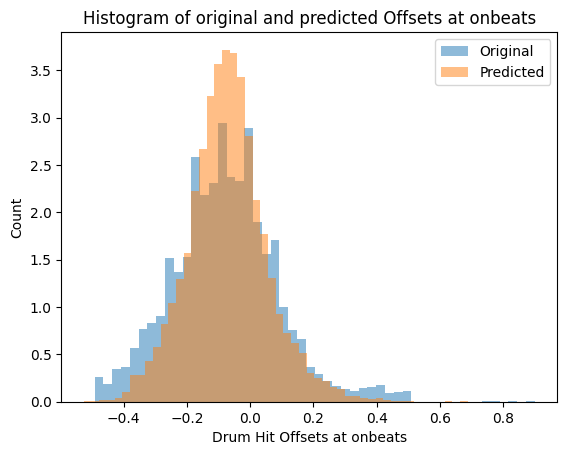

Histogram Intersection: 0.6873519287707004
KL Divergence: 14.59070629600727


In [10]:
plot_beat_distribution_at_pos_with_step(offsets_orig, offsets_pred, 0, 2, "Offsets at onbeats")

# Results

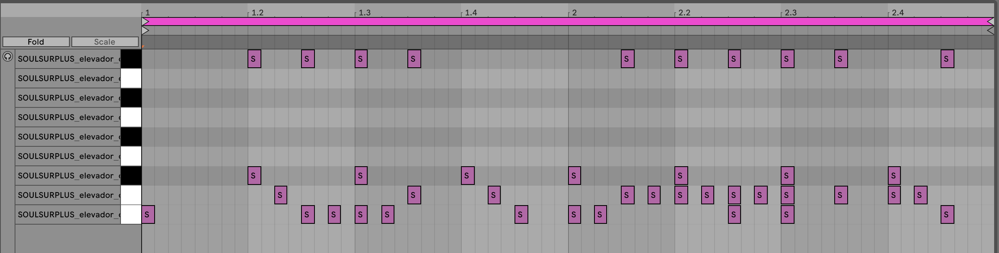

In [11]:
# Display quantized image 
Image('resources/images/quantized.png')

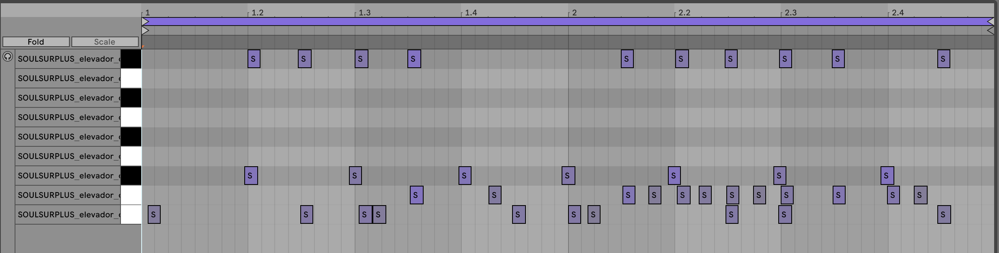

In [12]:
# Display predicted image 
Image('resources/images/predicted.png')

In [13]:
# Show audio examples
# Load the quantized and predicted audio
print("Quantized Audio")
display(Audio('resources/sounds/7-quantized.wav'))
print("Predicted Audio")
display(Audio('resources/sounds/7-humanized.wav'))

Quantized Audio


Predicted Audio


In [14]:
print("Quantized Audio")
display(Audio('resources/sounds/16-quantized.wav'))
print("Predicted Audio")
display(Audio('resources/sounds/16-humanized.wav'))

Quantized Audio


Predicted Audio


In [15]:
print("Quantized Audio")
display(Audio('resources/sounds/152-quantized.wav'))
print("Predicted Audio")
display(Audio('resources/sounds/152-humanized.wav'))

Quantized Audio


Predicted Audio


In [16]:
print("Quantized Audio")
display(Audio('resources/sounds/418-quantized.wav'))
print("Predicted Audio")
display(Audio('resources/sounds/418-humanized.wav'))

Quantized Audio


Predicted Audio
